# Image vs Text Clustering

In [1]:
import torch
import numpy as np
import pandas as pd
import torch.nn.functional as pyf
import matplotlib.pyplot as graph
from datasets import load_dataset
from transformers import AutoTokenizer, AutoModel, AutoImageProcessor
from sklearn.neighbors import NearestNeighbors
from tqdm.auto import tqdm
from IPython.display import display, Markdown


def get_image_embedding(image: list, preprocessor, model):
    with torch.inference_mode():
        img = preprocessor(images=image, return_tensors="pt")
        embeddings = model(**img)
        embeddings = embeddings['pooler_output']
        embeddings = pyf.normalize(embeddings, p=2, dim=1)
    return embeddings


def get_text_embedding(text: list, tokenizer, text_model):
    def mean_pooling(model_output, attention_mask):
        token_embeddings = model_output[0]  # First element of model_output contains all token embeddings
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)
    
    with torch.inference_mode():
        encoded = tokenizer(text, padding=True, truncation=True, return_tensors='pt')
        output = text_model(**encoded)
        embeddings = mean_pooling(output, encoded['attention_mask'])
        embeddings = pyf.normalize(embeddings, p=2, dim=1)
    return embeddings


image_ds = load_dataset('lambdalabs/pokemon-blip-captions')
display(image_ds)

data = pd.read_csv('data/pokemon-text-descriptions.csv')
display(data.head())

#################################################################################################
# Setup the Embedding Models
#################################################################################################

/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 833
    })
})

,index,response
0,0,1. The creature is green.\n2. The creature loo...
1,1,1. The creature is green with yellow spots.\n2...
2,2,1. The creature is red and white.\n2. The crea...
3,3,1. The creature is white with red lips and a r...
4,4,1. The creature is pink.\n2. The creature look...


In [2]:
# Text embedding model
base_text_model = 'sentence-transformers/all-mpnet-base-v2'
tokenizer = AutoTokenizer.from_pretrained(base_text_model)
text_model = AutoModel.from_pretrained(base_text_model)

In [3]:
# Image embedding model
base_image_model = 'google/vit-base-patch16-224-in21k'
image_preprocessor = AutoImageProcessor.from_pretrained(base_image_model)
image_model = AutoModel.from_pretrained(base_image_model)

# Generate all Embeddings

In [4]:
text_embeddings = get_text_embedding(data['response'].tolist(), tokenizer, text_model)
data['text_embedding'] = [vec for vec in tqdm(text_embeddings.cpu().detach().numpy())]

print(text_embeddings.shape)
print(text_embeddings)
display(data.head())

100%|██████████| 833/833 [00:00<00:00, 2082154.49it/s]

torch.Size([833, 768])
tensor([[ 0.0206, -0.0140, -0.0108,  ...,  0.0433,  0.0274, -0.0276],
        [ 0.0356, -0.0652, -0.0201,  ...,  0.0375,  0.0652, -0.0276],
        [ 0.0899, -0.0109,  0.0013,  ...,  0.0208, -0.0328, -0.0195],
        ...,
        [ 0.0218, -0.0313, -0.0177,  ...,  0.0403,  0.0090, -0.0095],
        [ 0.0542,  0.0011, -0.0042,  ...,  0.0297,  0.0072, -0.0179],
        [ 0.0858, -0.0013,  0.0017,  ...,  0.0204, -0.0369, -0.0113]])


,index,response,text_embedding
0,0,1. The creature is green.\n2. The creature loo...,"[0.020570153, -0.013991997, -0.010794295, -0.0..."
1,1,1. The creature is green with yellow spots.\n2...,"[0.035647094, -0.065157816, -0.020064875, -0.0..."
2,2,1. The creature is red and white.\n2. The crea...,"[0.0898718, -0.010889447, 0.0012938322, -0.007..."
3,3,1. The creature is white with red lips and a r...,"[0.053993937, 0.007887579, -0.007690347, -0.01..."
4,4,1. The creature is pink.\n2. The creature look...,"[0.06338696, -0.018508058, -0.012493585, 0.006..."


In [5]:
image_embeddings = get_image_embedding(
    [image_ds['train'][i]['image'] for i in tqdm(data['index'].tolist(), desc='Loading Images')],
    image_preprocessor,
    image_model
)
data['image_embedding'] = [vec for vec in tqdm(image_embeddings.cpu().detach().numpy())]
print(image_embeddings.shape)
print(image_embeddings)
display(data.head())

100%|██████████| 833/833 [00:00<00:00, 2422923.18it/s]

torch.Size([833, 768])
tensor([[ 0.0174,  0.0254,  0.0014,  ..., -0.0100, -0.0060, -0.0207],
        [ 0.0353, -0.0126, -0.0409,  ...,  0.0130,  0.0386, -0.0221],
        [-0.0177, -0.0462, -0.0270,  ...,  0.0380,  0.0430, -0.0624],
        ...,
        [-0.0369,  0.0325, -0.0722,  ...,  0.0290,  0.0009,  0.0202],
        [ 0.0603, -0.0230, -0.0411,  ..., -0.0088,  0.0316, -0.0563],
        [ 0.0572, -0.0018, -0.0102,  ..., -0.0192, -0.0190, -0.0616]])


,index,response,text_embedding,image_embedding
0,0,1. The creature is green.\n2. The creature loo...,"[0.020570153, -0.013991997, -0.010794295, -0.0...","[0.017438548, 0.02536539, 0.0014037568, 0.0297..."
1,1,1. The creature is green with yellow spots.\n2...,"[0.035647094, -0.065157816, -0.020064875, -0.0...","[0.035314538, -0.012637096, -0.04092098, 0.012..."
2,2,1. The creature is red and white.\n2. The crea...,"[0.0898718, -0.010889447, 0.0012938322, -0.007...","[-0.017658025, -0.046223603, -0.02702056, -0.0..."
3,3,1. The creature is white with red lips and a r...,"[0.053993937, 0.007887579, -0.007690347, -0.01...","[0.018707959, 0.03430888, -0.014913888, 0.0054..."
4,4,1. The creature is pink.\n2. The creature look...,"[0.06338696, -0.018508058, -0.012493585, 0.006...","[0.05724998, 0.034569226, -0.0065274746, 0.058..."


# Display Results

In [6]:
# Get samples
samples = data.sample(30, random_state=42)
display(samples)

# Create embedding models
text_matcher = NearestNeighbors(n_neighbors=5, metric='cosine', n_jobs=-1)
text_matcher.fit(np.vstack(data['text_embedding'].tolist()))
display(text_matcher)

image_matcher = NearestNeighbors(n_neighbors=5, metric='cosine', n_jobs=-1)
image_matcher.fit(np.vstack(data['image_embedding'].tolist()))
display(image_matcher)

# Get the nearest neighbors
text_neighbors = text_matcher.kneighbors(np.vstack(samples['text_embedding'].tolist()), return_distance=False)
image_neighbors = image_matcher.kneighbors(np.vstack(samples['image_embedding'].tolist()), return_distance=False)

,index,response,text_embedding,image_embedding
610,610,1. The creature is brown and white.\n2. The cr...,"[0.014301527, 0.02129415, -0.015431338, -0.012...","[-0.005719435, -0.011953182, -0.025508186, 0.0..."
820,820,1. The creature is blue.\n2. The creature look...,"[0.04580675, -0.0923883, -0.01993787, -0.00176...","[0.0028559323, -0.027960742, -0.06181058, 0.01..."
290,290,1. The creature is green.\n2. The creature loo...,"[0.051194962, -0.08629612, -0.004306327, 0.017...","[-0.022029692, 0.04343758, -0.056140512, -0.00..."
798,798,1. The creature is primarily pink with some pu...,"[0.059616778, -0.021776233, -0.01722653, 0.005...","[-0.0064663454, -0.012339471, -0.07402304, 0.0..."
168,168,1. The creature is yellow.\n2. The creature lo...,"[0.086182185, -0.06696891, -0.0071514333, 0.01...","[-0.062338315, -0.024568448, -0.024816079, -0...."
688,688,1. The creature is primarily blue with red and...,"[0.02562393, -0.06686704, -0.021104144, -0.029...","[0.008283351, -0.007296252, -0.07379595, 0.002..."
819,819,1. The creature is purple.\n2. The creature lo...,"[0.08143418, 0.01498573, -0.0041089305, -0.000...","[0.042238176, -0.035406824, 0.016374182, 0.033..."
86,86,1. The creature is blue.\n2. The creature look...,"[0.022101788, -0.04111861, -0.03108439, -0.007...","[-0.0044404133, 0.043613333, -0.061116803, 0.0..."
260,260,1. The creature is pink.\n2. The creature look...,"[0.05237311, -0.040151015, -0.018569143, 0.002...","[0.004254526, -0.015673507, -0.054114386, -0.0..."
548,548,1. The creature is brown.\n2. The creature loo...,"[0.047554664, -0.032953173, -0.031207548, 0.03...","[-0.05304855, -0.0009833471, -0.056019228, -0...."


NearestNeighbors(metric='cosine', n_jobs=-1)

NearestNeighbors(metric='cosine', n_jobs=-1)

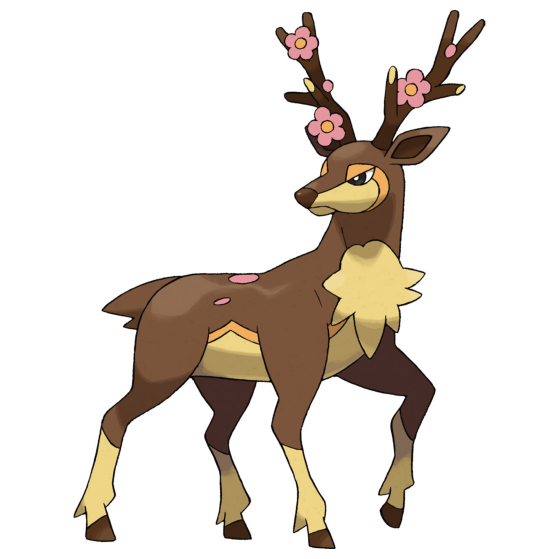

1. The creature is brown and white.
2. The creature looks friendly. It has a gentle expression with its eyes closed and a slight smile, which suggests a sense of contentment or relaxation.

### Matched by generated text

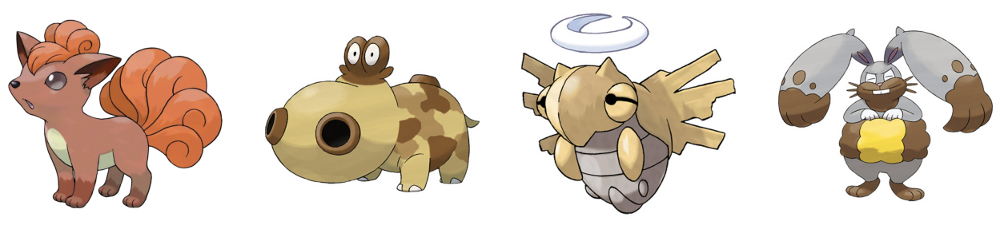

### Matched by raw image

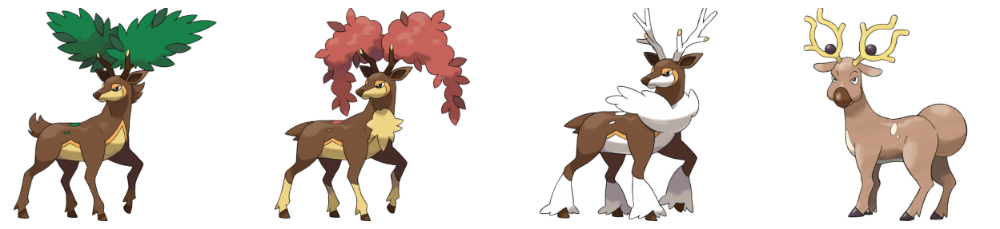

---

---

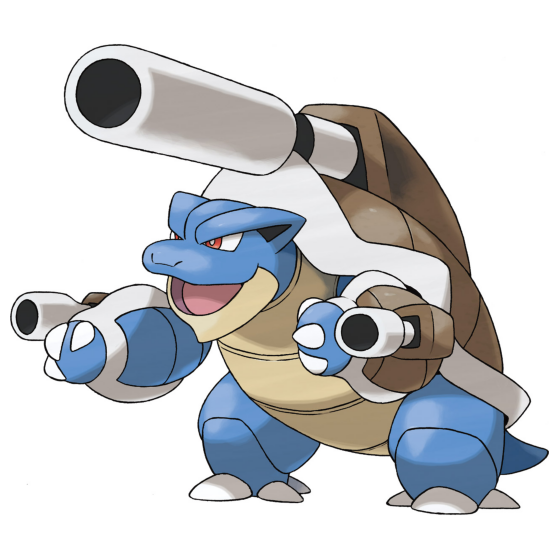

1. The creature is blue.
2. The creature looks very friendly. It has a big smile and its arms are outstretched, which can be interpreted as a welcoming gesture.

### Matched by generated text

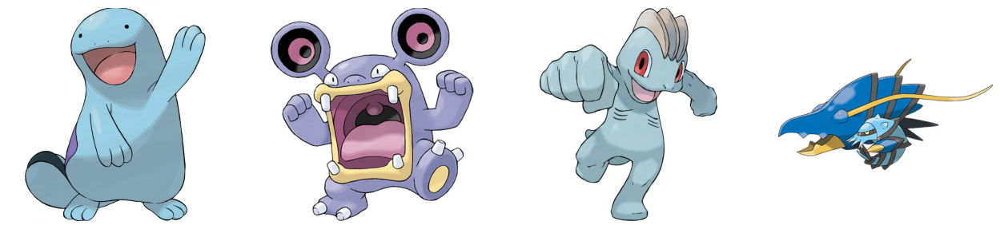

### Matched by raw image

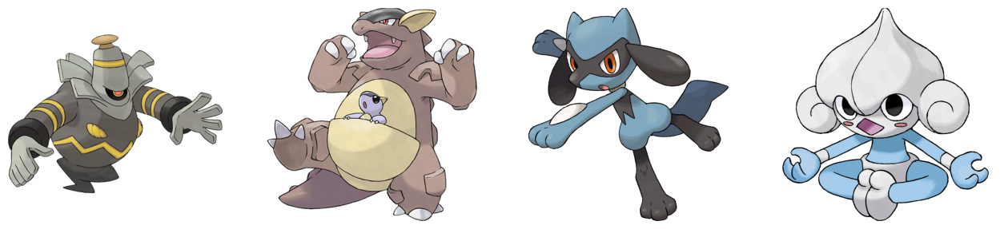

---

---

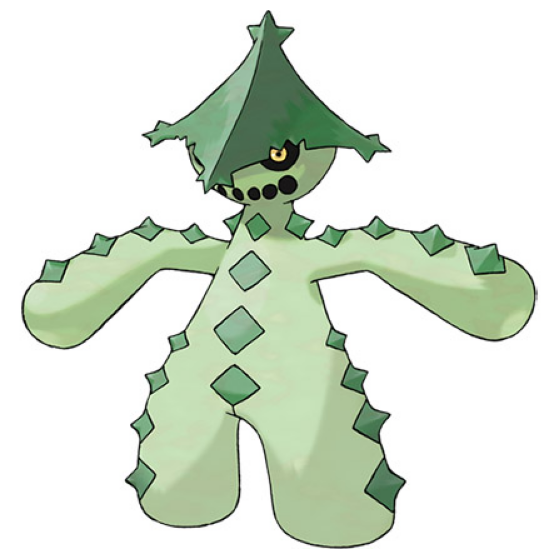

1. The creature is green.
2. The creature looks unfriendly due to its sharp spikes and the menacing expression on its face.

### Matched by generated text

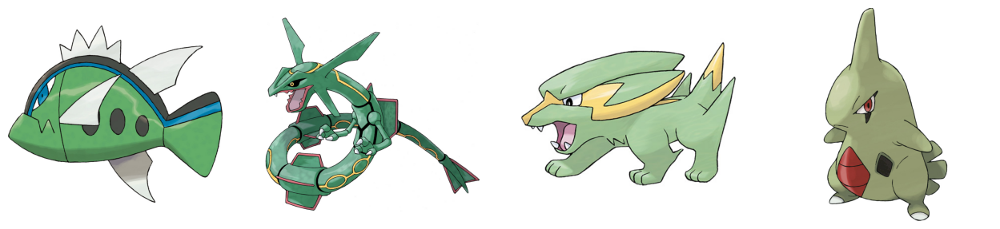

### Matched by raw image

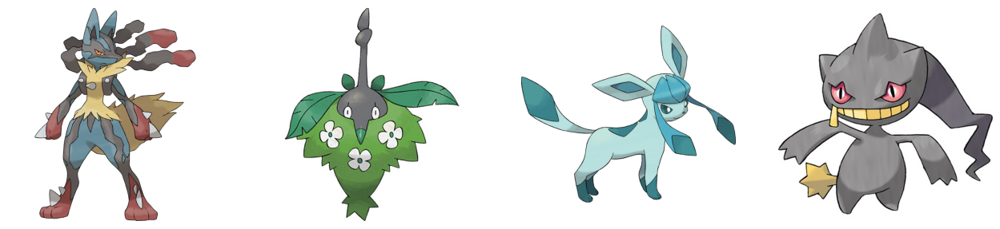

---

---

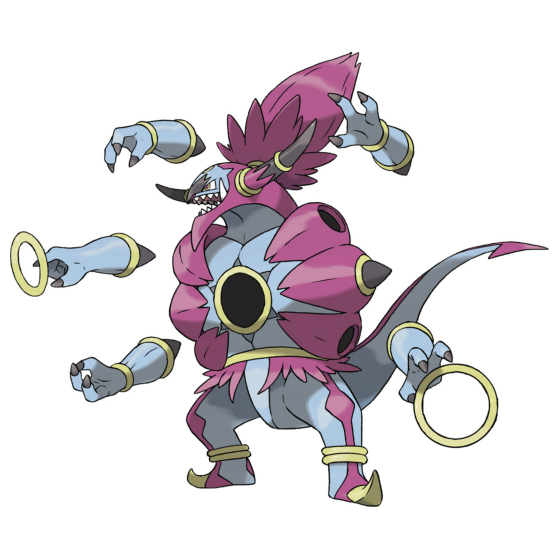

1. The creature is primarily pink with some purple and blue accents.
2. The creature looks unfriendly due to its sharp teeth, intense facial expression, and the overall aggressive stance with its arms outstretched and claws extended.

### Matched by generated text

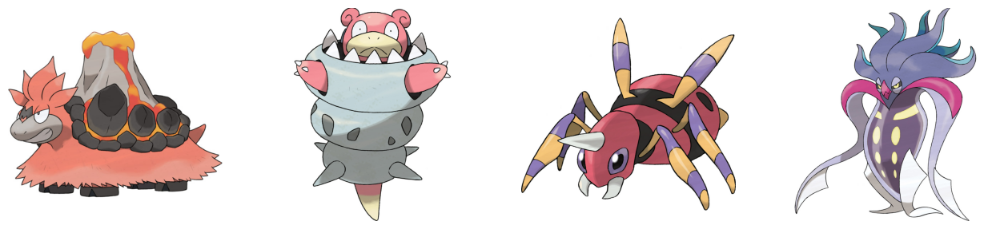

### Matched by raw image

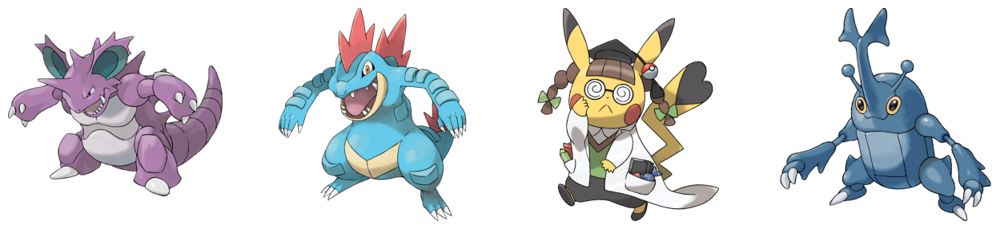

---

---

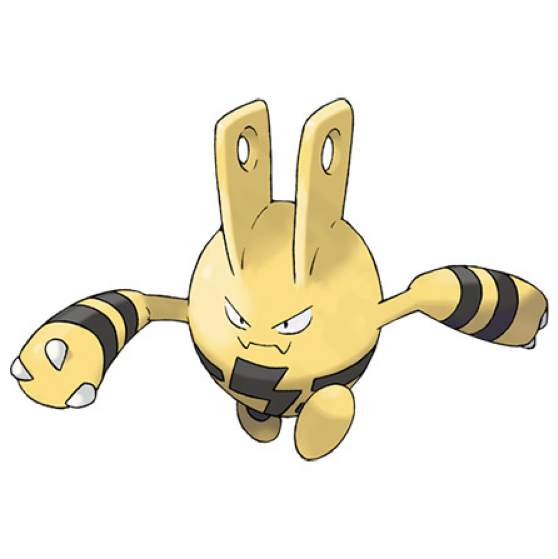

1. The creature is yellow.
2. The creature looks unfriendly due to its sharp teeth and angry facial expression.

### Matched by generated text

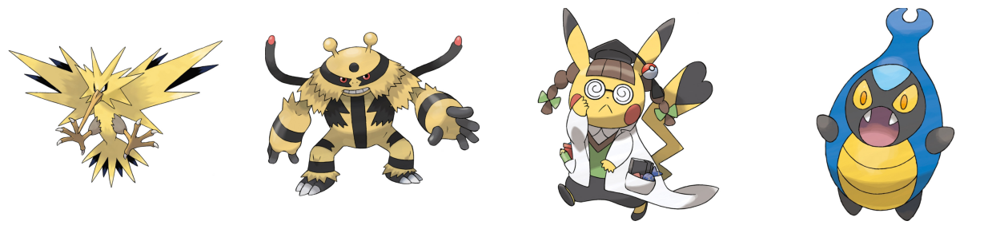

### Matched by raw image

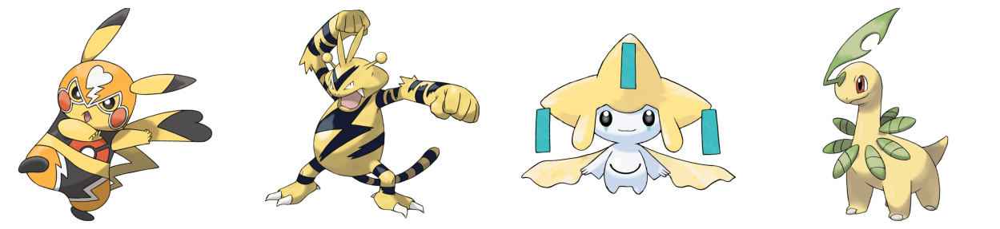

---

---

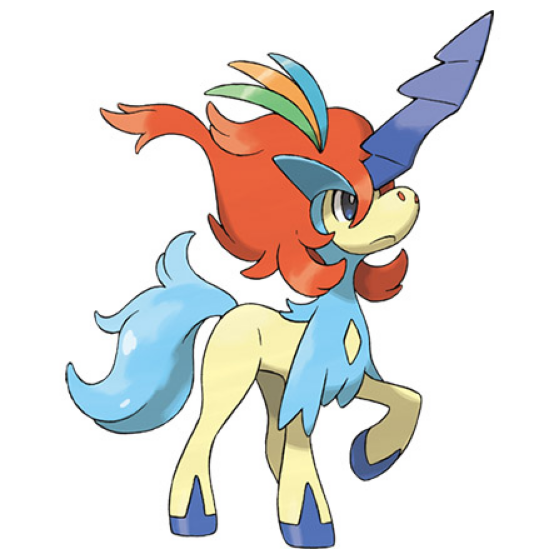

1. The creature is primarily blue with red and orange accents.
2. The creature looks somewhat unfriendly due to its stern expression and the pointed, elongated shape of its ears, which can sometimes be associated with aggression or alertness in certain animals.

### Matched by generated text

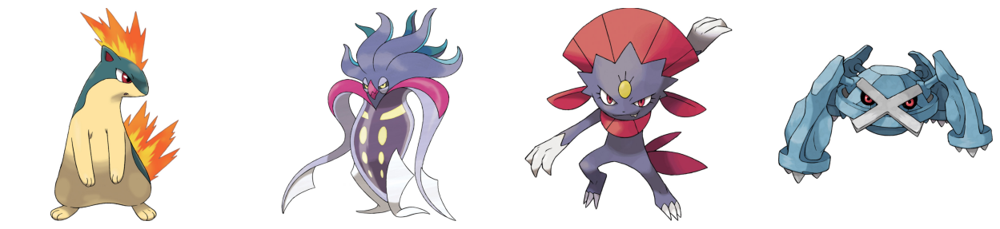

### Matched by raw image

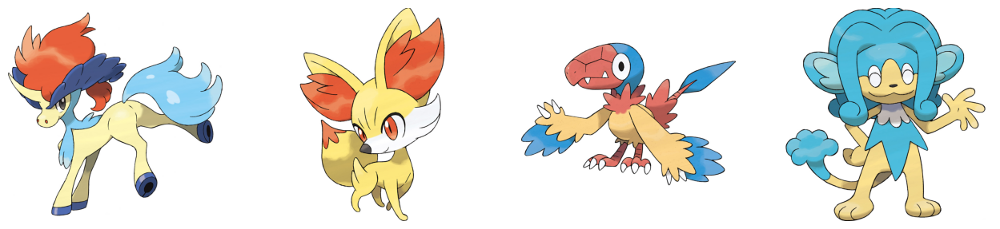

---

---

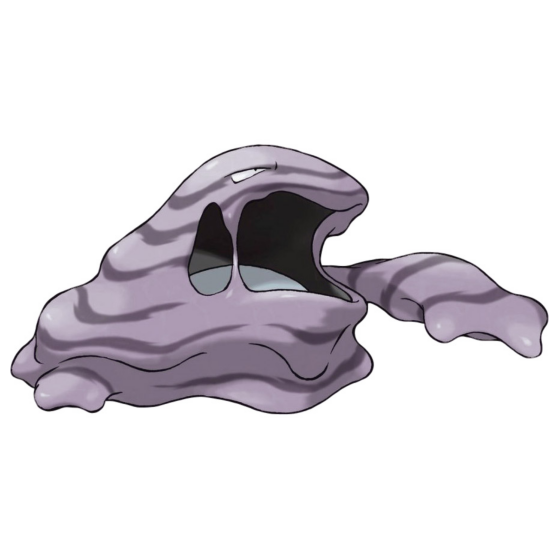

1. The creature is purple.
2. The creature looks unfriendly due to its large, open mouth and the way it is depicted as a monster in a cartoon.

### Matched by generated text

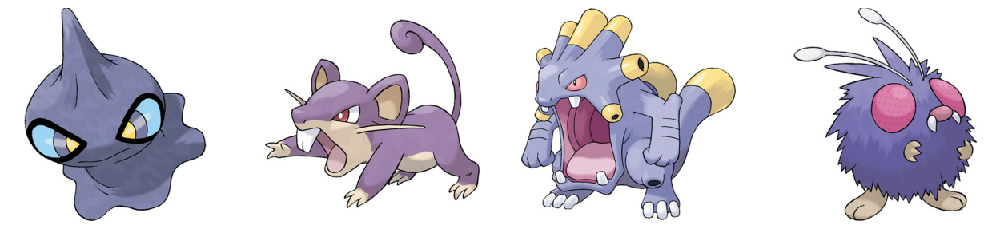

### Matched by raw image

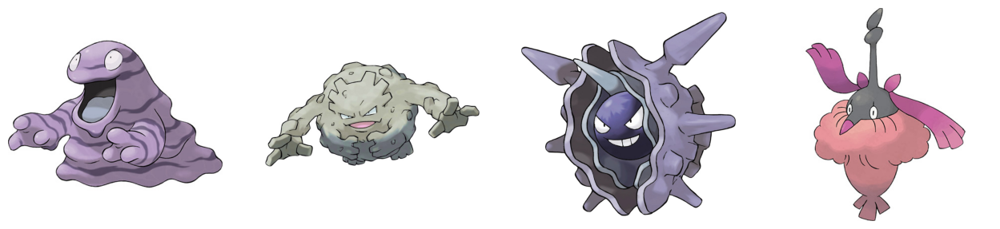

---

---

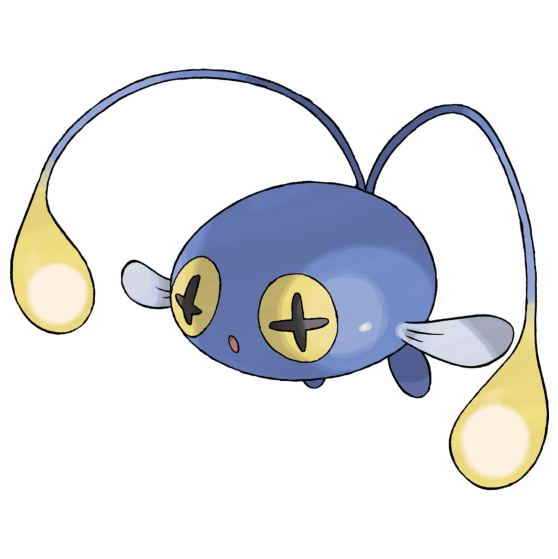

1. The creature is blue.
2. The creature looks very friendly. It has big, expressive eyes and a wide, welcoming smile. The overall shape and design of the creature suggest that it is meant to be cute and appealing.

### Matched by generated text

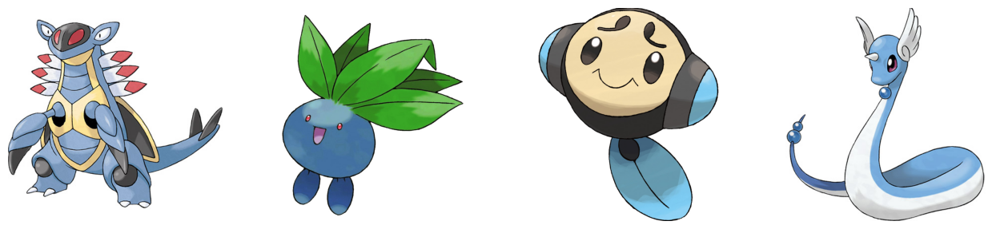

### Matched by raw image

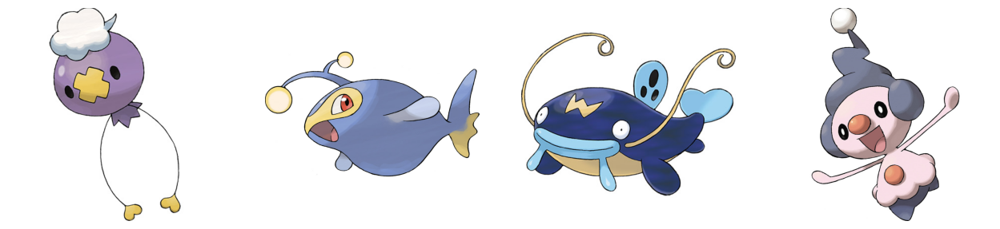

---

---

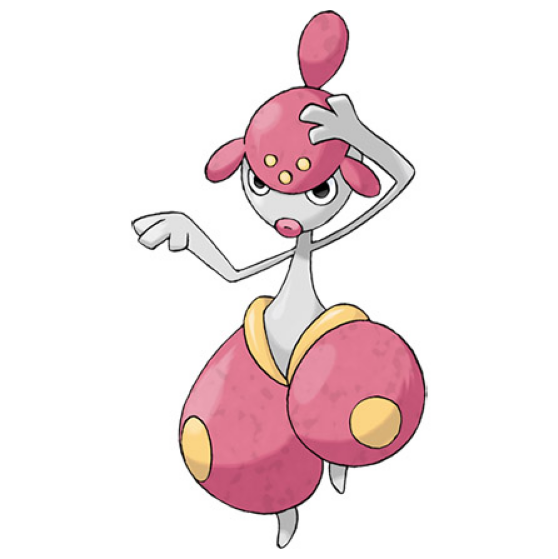

1. The creature is pink.
2. The creature looks unfriendly due to its expression and the way it is holding its hands.

### Matched by generated text

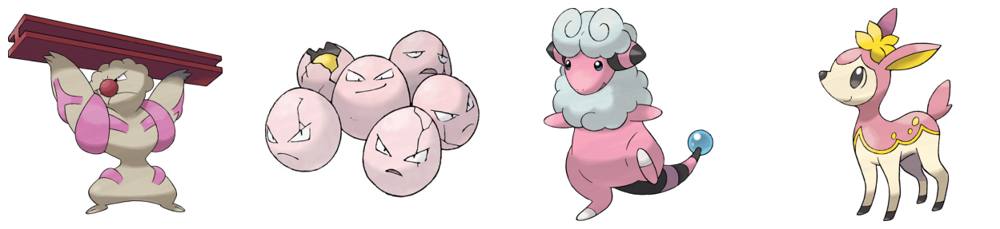

### Matched by raw image

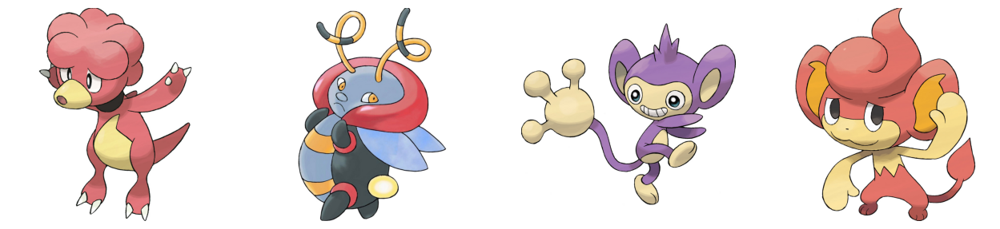

---

---

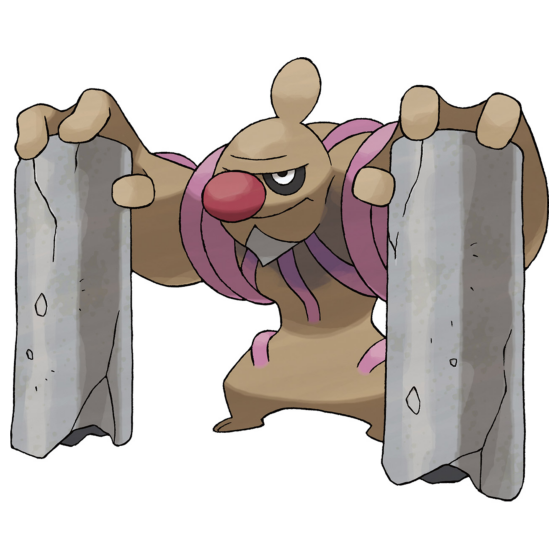

1. The creature is brown.
2. The creature looks unfriendly due to its intense stare and the way it is holding up large rocks, which could be perceived as a threat or a display of strength.

### Matched by generated text

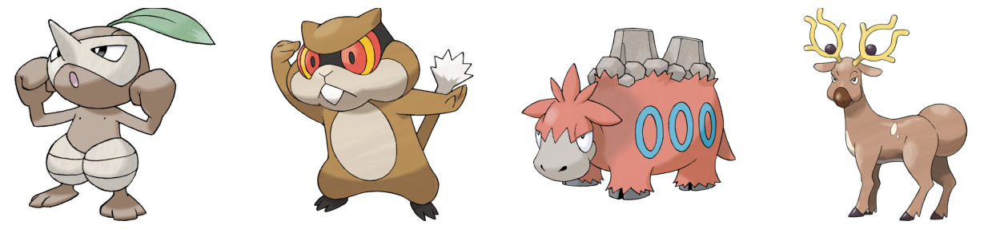

### Matched by raw image

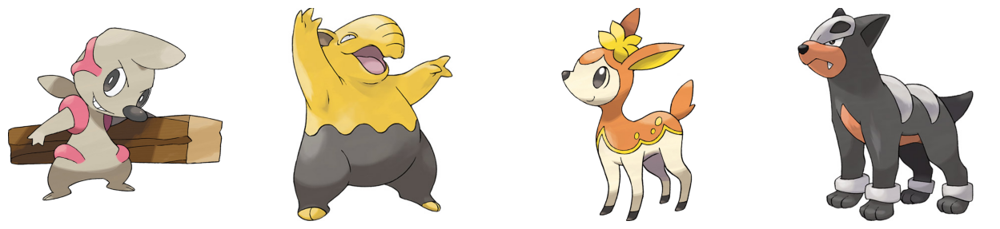

---

---

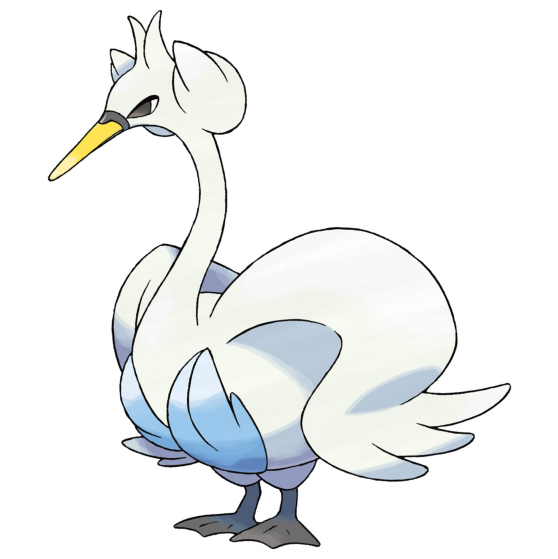

1. The creature is white.
2. The creature looks very friendly. It has a gentle expression with its eyes closed, and its body language is relaxed and open, with its wings spread wide.

### Matched by generated text

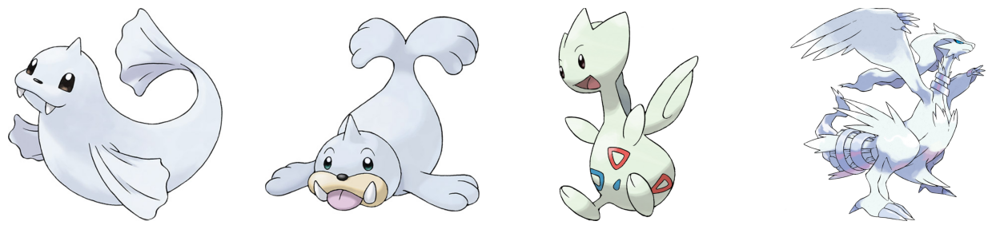

### Matched by raw image

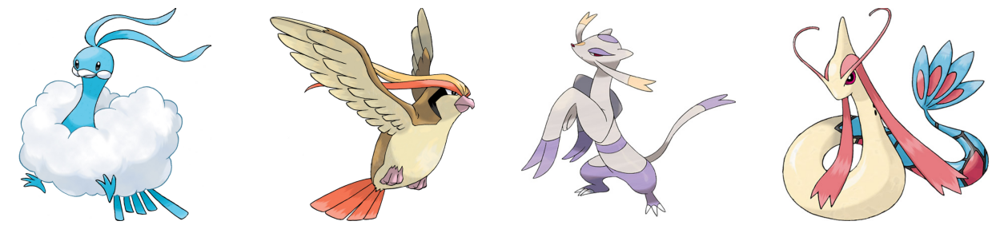

---

---

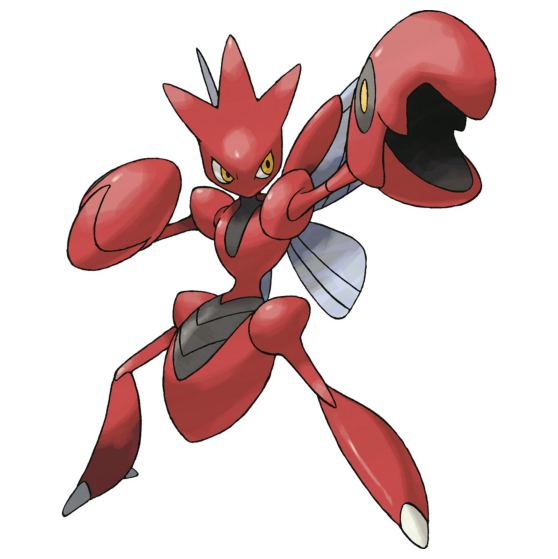

1. The creature is red.
2. The creature looks unfriendly due to its aggressive stance, with its arms outstretched and its mouth open, suggesting a display of dominance or a threat.

### Matched by generated text

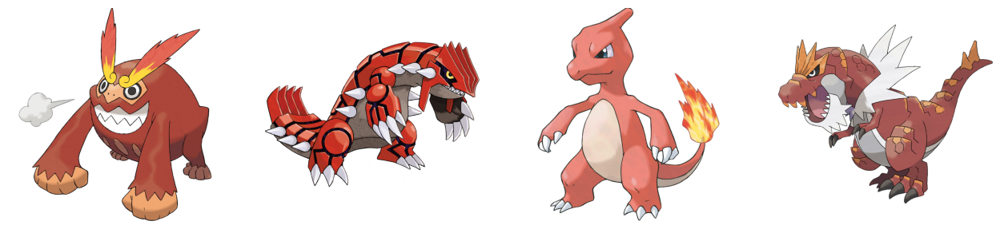

### Matched by raw image

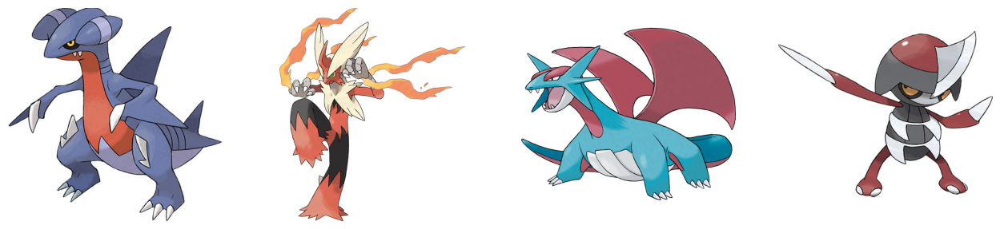

---

---

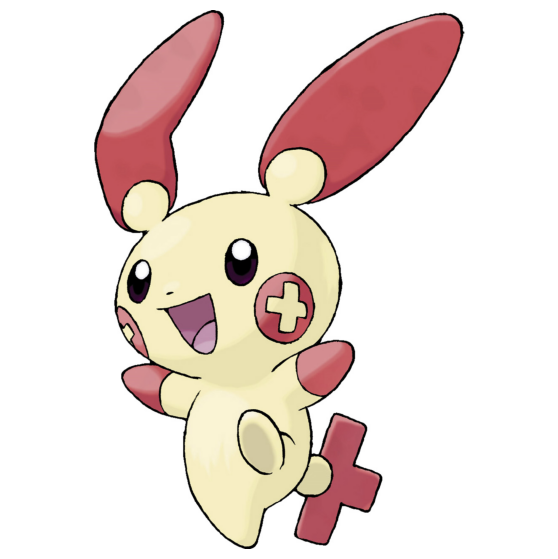

1. The creature is primarily yellow with red accents.
2. The creature looks friendly, with a big smile and a cheerful expression.

### Matched by generated text

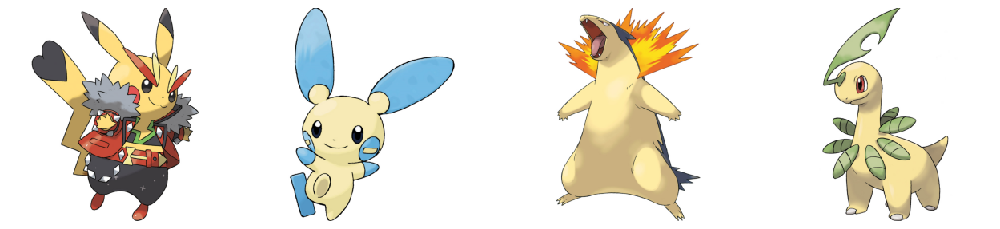

### Matched by raw image

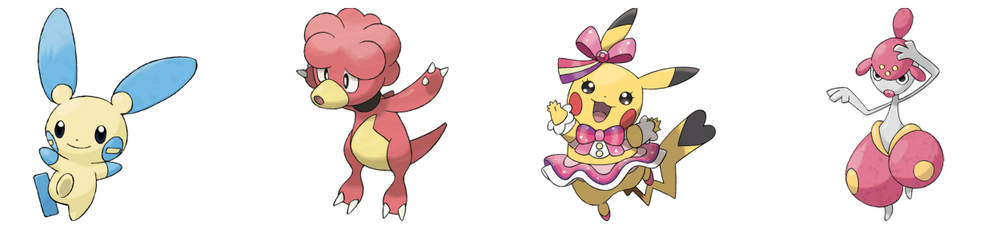

---

---

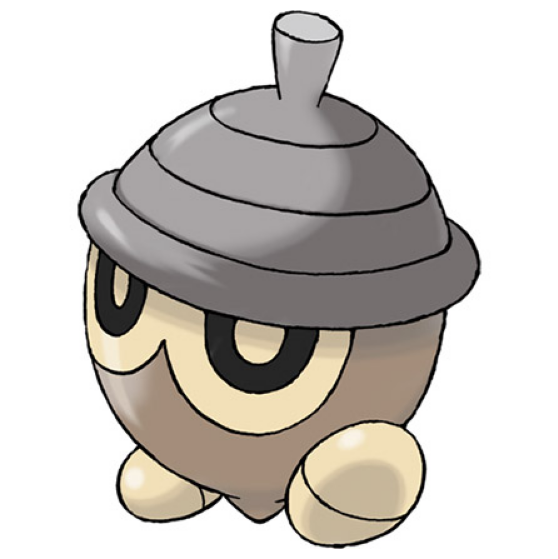

1. The creature is primarily brown with some black accents.
2. The creature has a neutral expression, which suggests it could be either friendly or unfriendly. Its neutral expression might indicate that it is not currently showing any strong emotions or intentions, so it's difficult to determine its friendliness or unfriendliness solely based on its facial expression.

### Matched by generated text

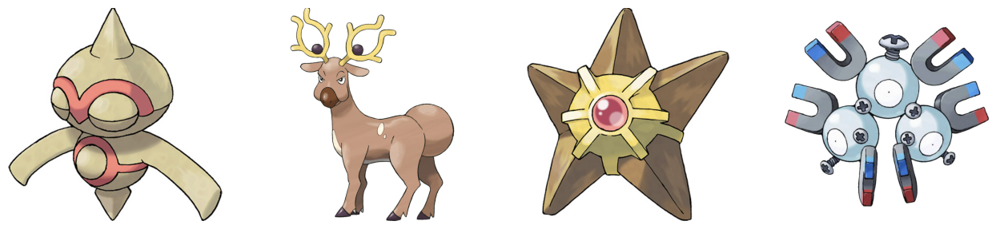

### Matched by raw image

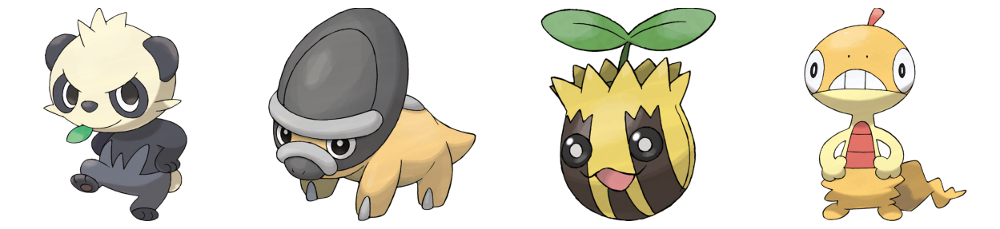

---

---

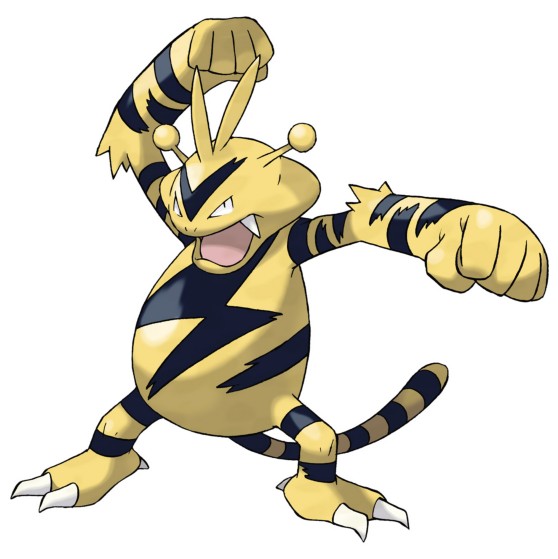

1. The creature is yellow and black.
2. The creature looks unfriendly due to its open mouth and the aggressive stance with its arms raised in the air.

### Matched by generated text

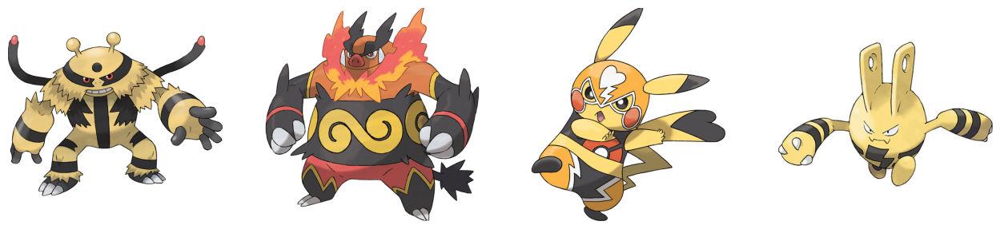

### Matched by raw image

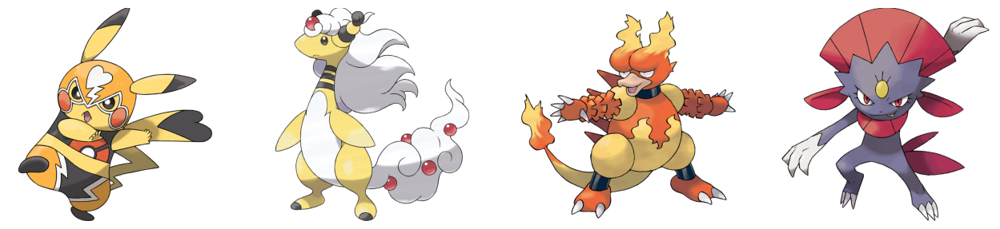

---

---

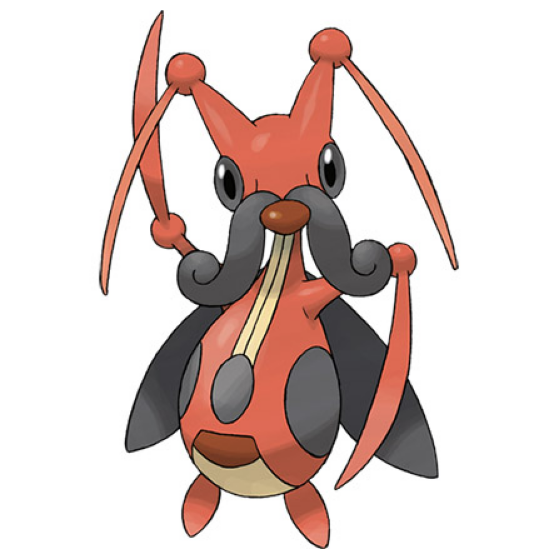

1. The creature is red.
2. The creature looks unfriendly due to its large, sharp teeth and the menacing expression on its face.

### Matched by generated text

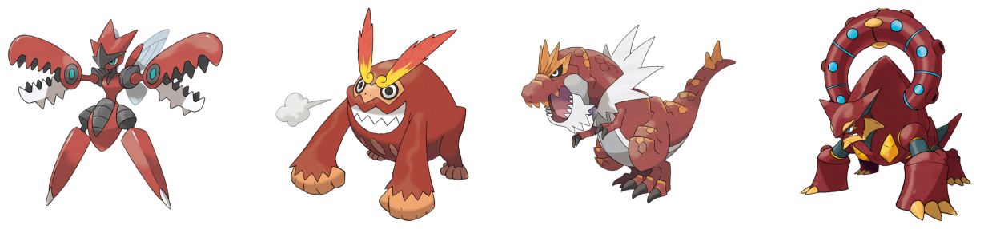

### Matched by raw image

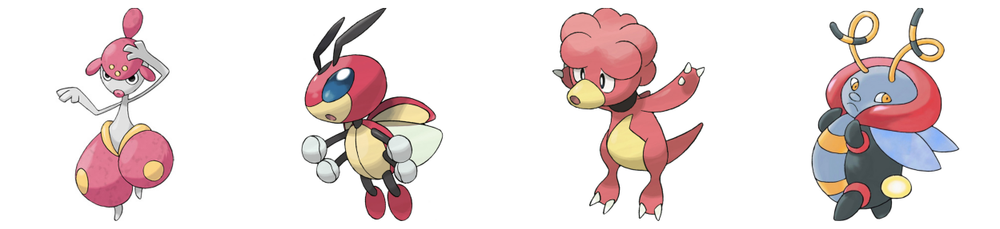

---

---

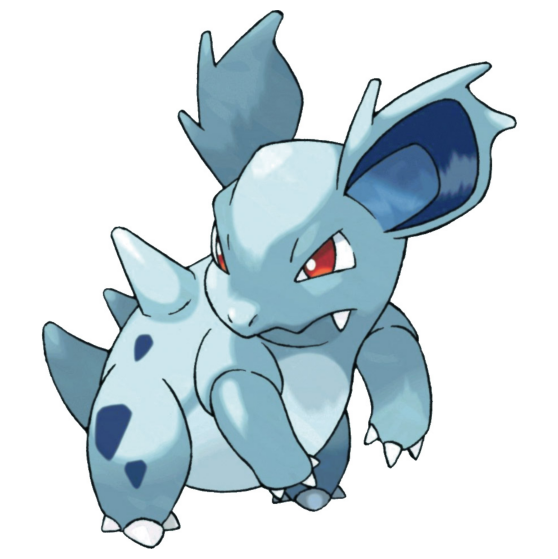

1. The creature is blue.
2. The creature looks unfriendly due to its wide-eyed stare and the way its mouth is open, which could be interpreted as a snarl or a hiss.

### Matched by generated text

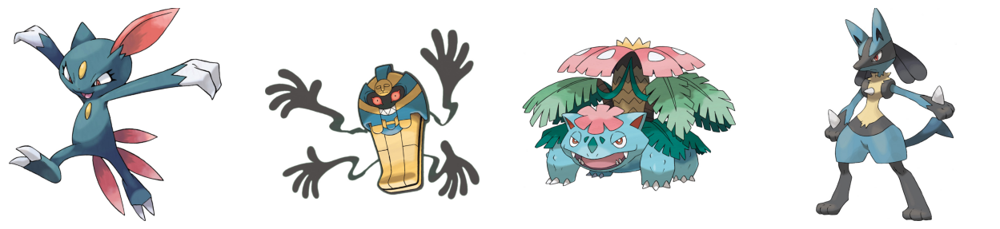

### Matched by raw image

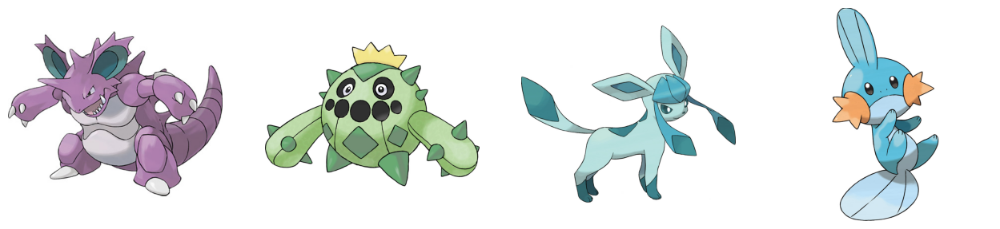

---

---

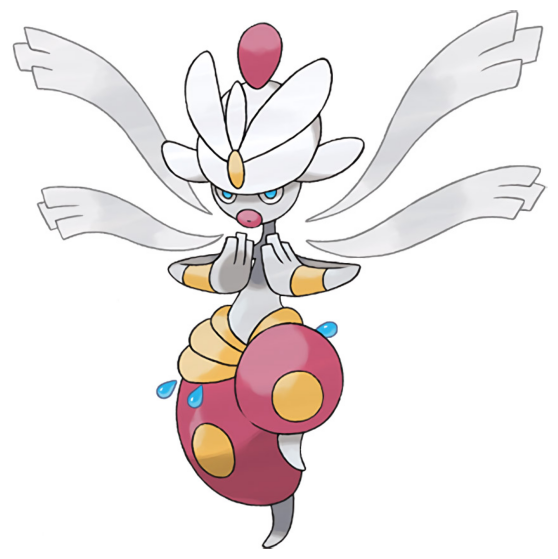

1. The creature is primarily white with pink accents.
2. The creature has a neutral expression and a relaxed posture, suggesting it is neither particularly friendly nor unfriendly.

### Matched by generated text

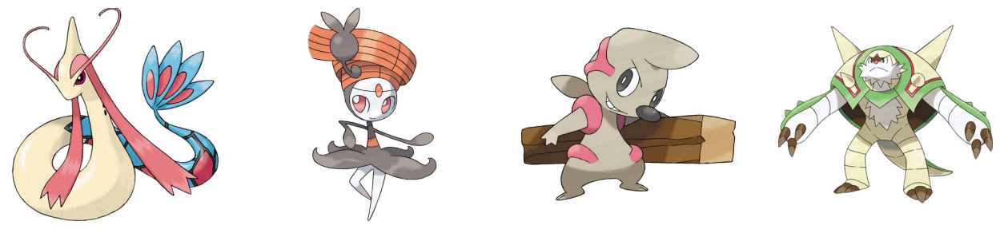

### Matched by raw image

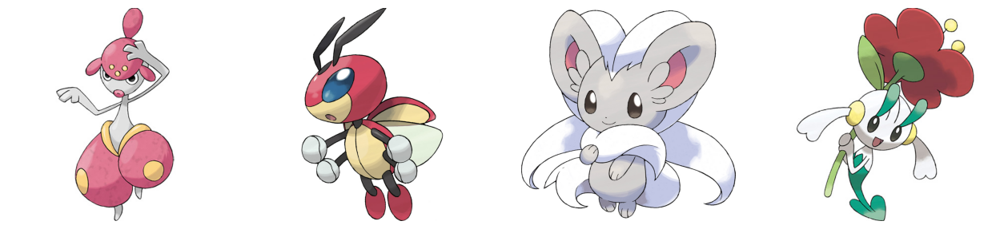

---

---

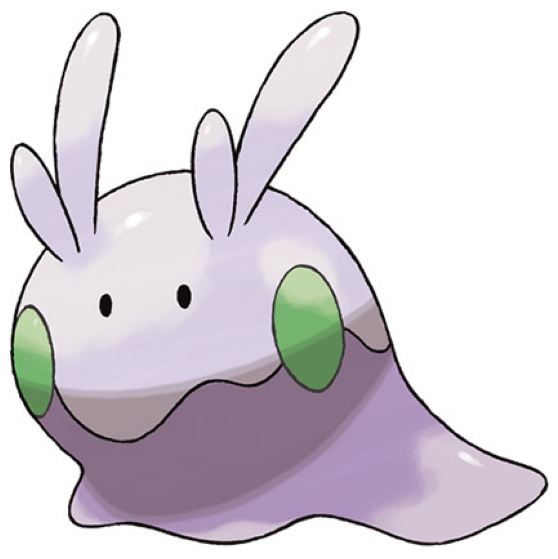

1. The creature is purple with green accents.
2. The creature looks friendly due to its large, expressive eyes and the overall cute appearance of its design.

### Matched by generated text

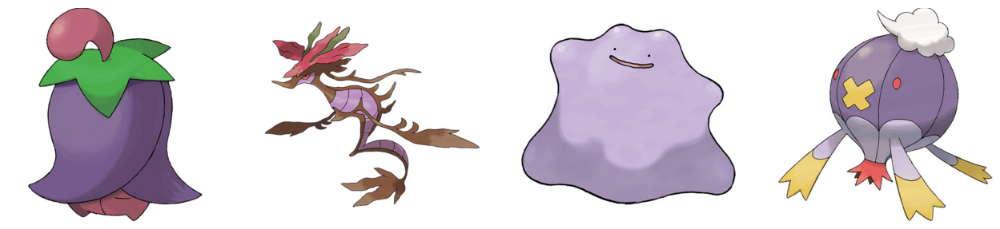

### Matched by raw image

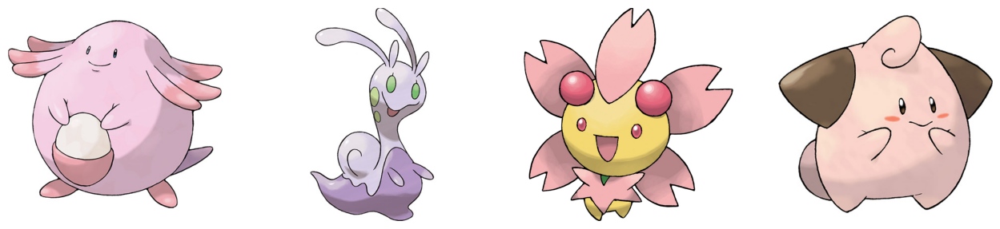

---

---

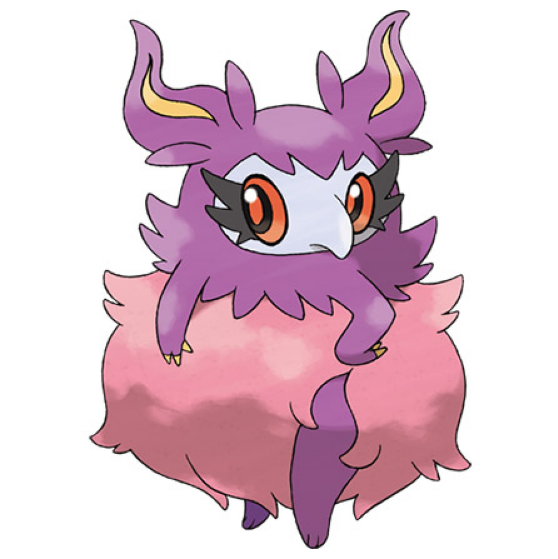

1. The creature is purple.
2. The creature looks unfriendly due to its large, sharp teeth and piercing eyes, which can be interpreted as a threat or danger.

### Matched by generated text

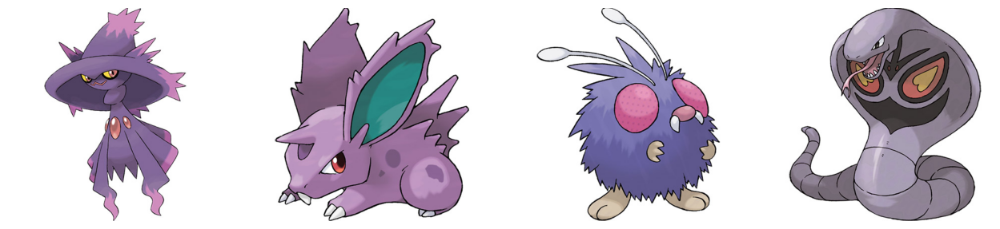

### Matched by raw image

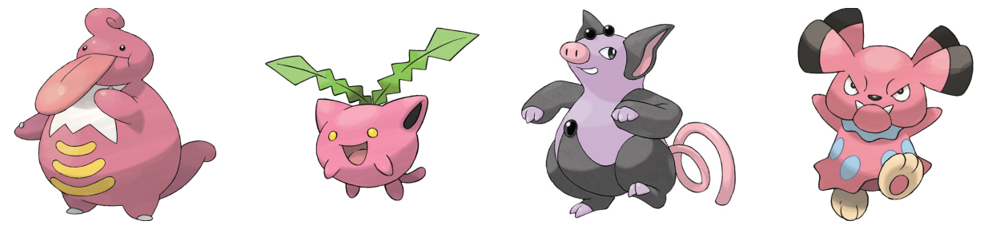

---

---

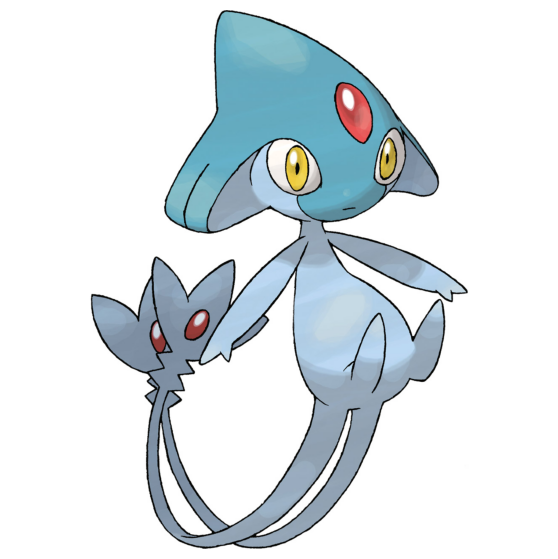

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests a relaxed and welcoming demeanor.

### Matched by generated text

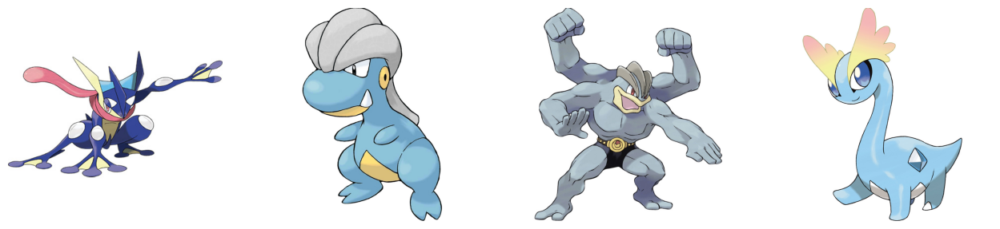

### Matched by raw image

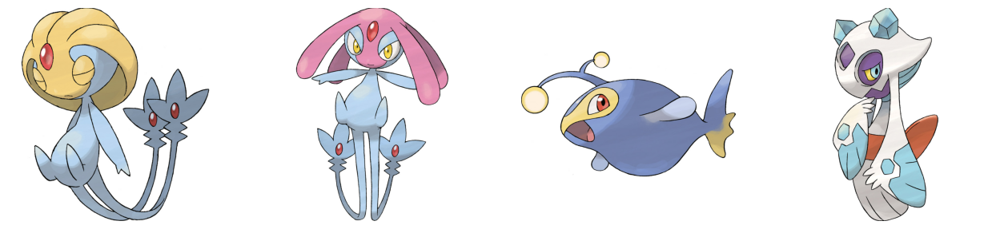

---

---

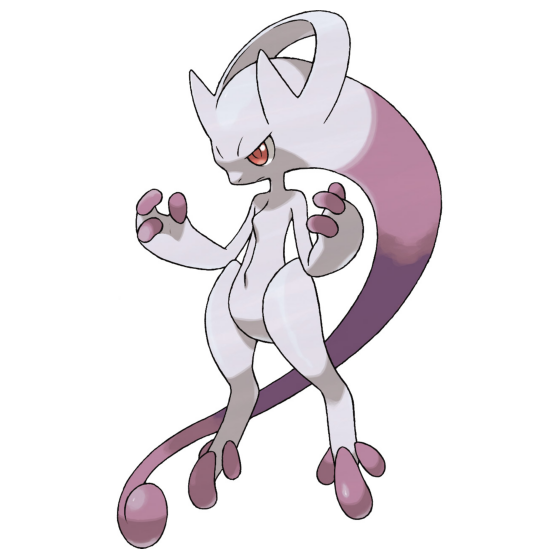

1. The creature is white.
2. The creature looks unfriendly. It has a ferocious expression with its mouth open and its eyes are glowing red, indicating aggression or a threat.

### Matched by generated text

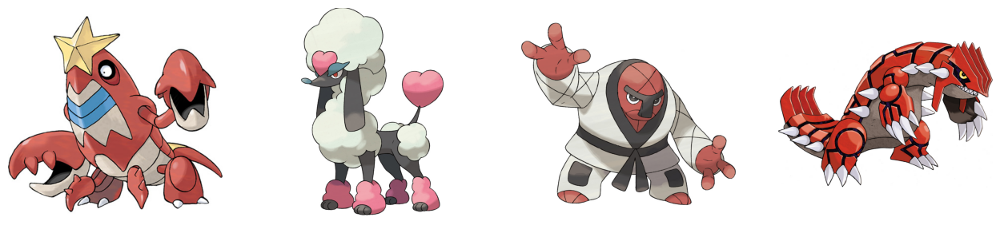

### Matched by raw image

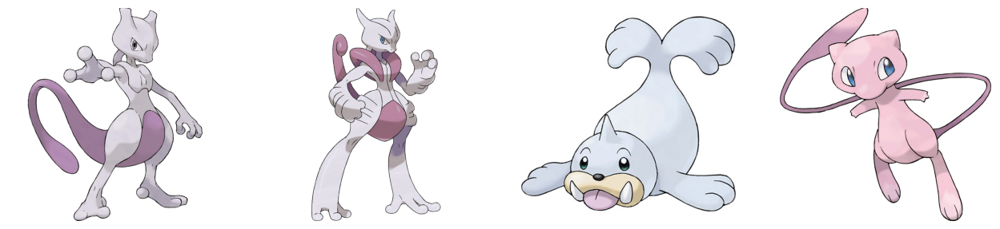

---

---

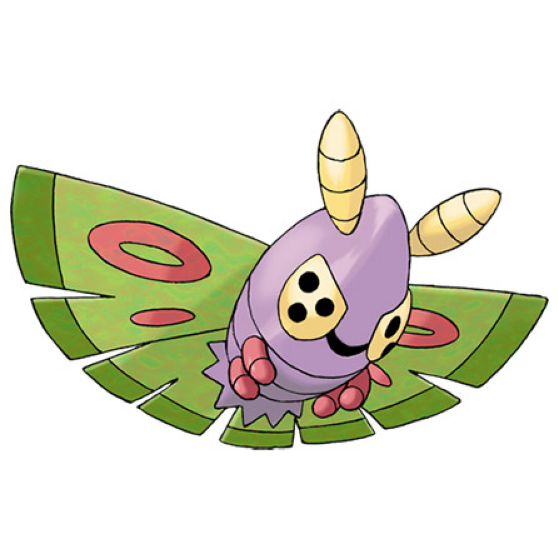

1. The creature is purple.
2. The creature looks friendly. It has a big smile and is holding out its hands, which can be interpreted as a welcoming gesture.

### Matched by generated text

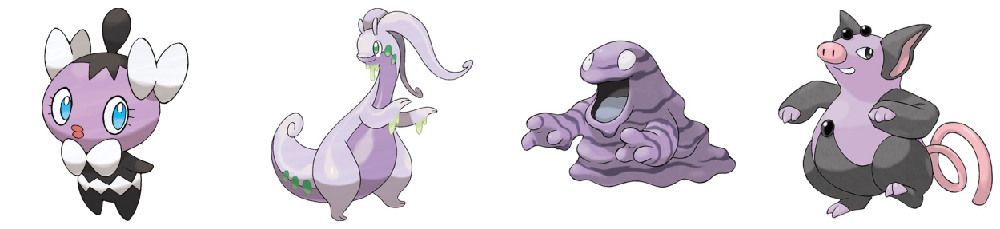

### Matched by raw image

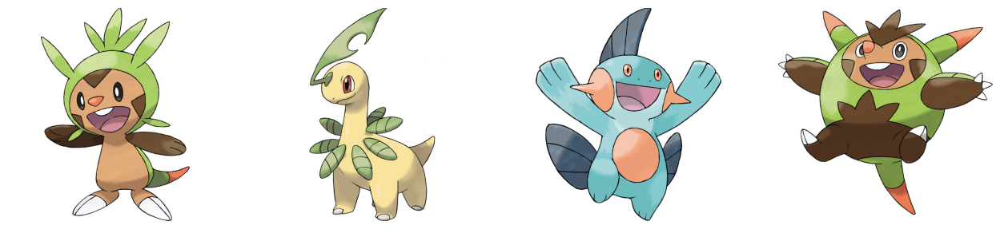

---

---

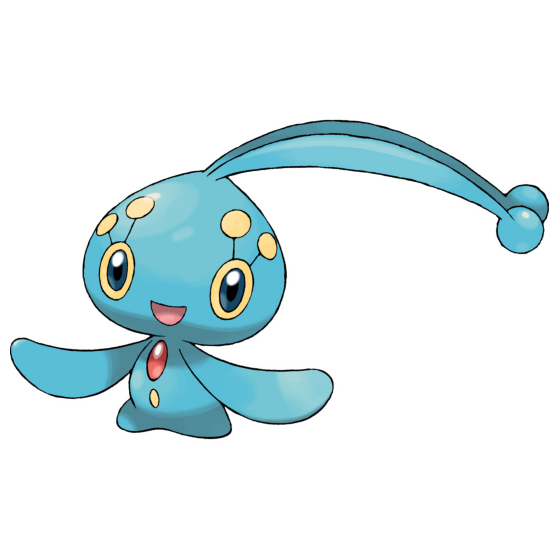

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests it is comfortable and content.

### Matched by generated text

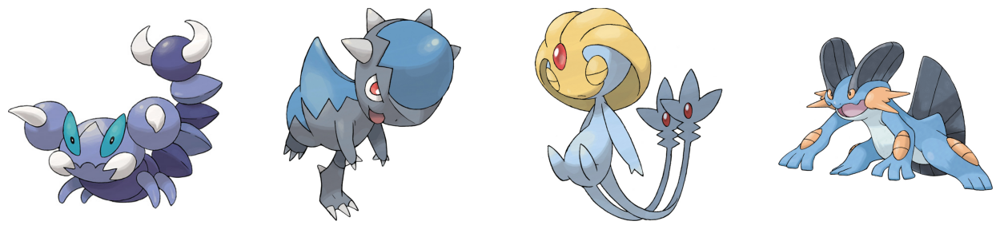

### Matched by raw image

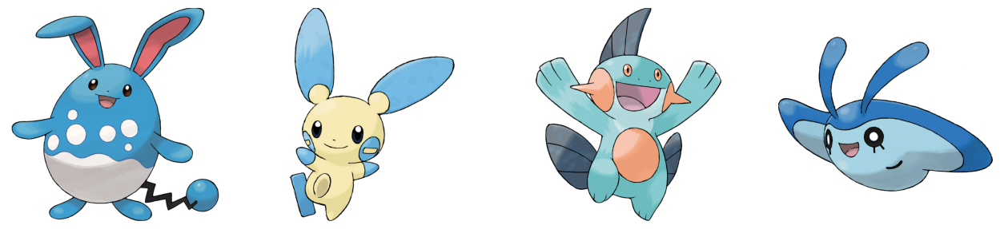

---

---

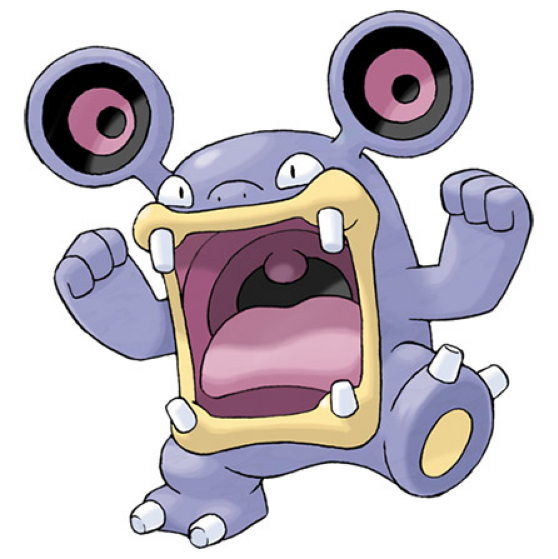

1. The creature is blue.
2. The creature looks very friendly, as it has a big smile and its arms are outstretched in a welcoming gesture.

### Matched by generated text

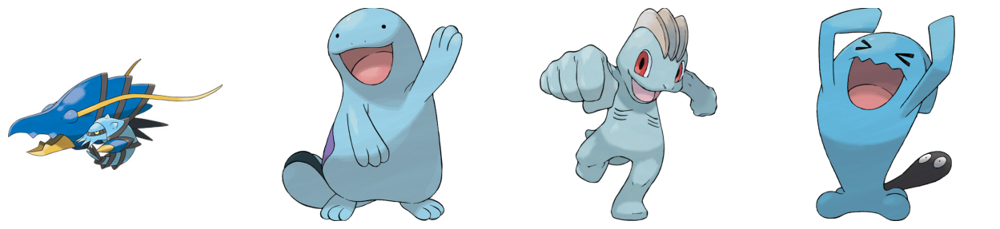

### Matched by raw image

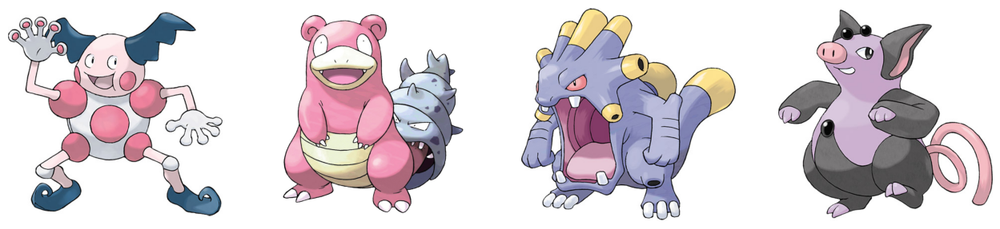

---

---

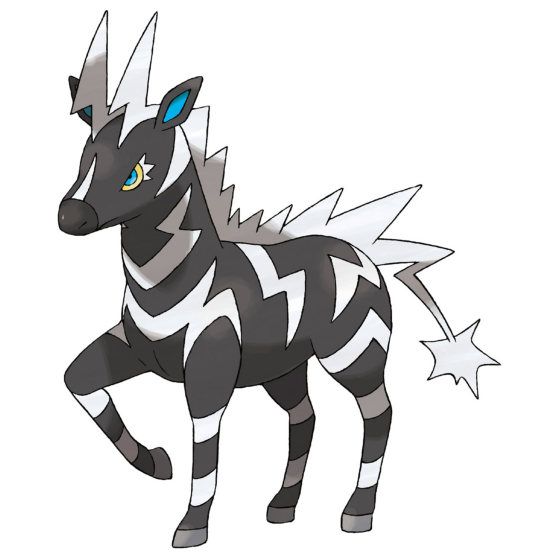

1. The creature is black and white.
2. The creature looks unfriendly due to its sharp, pointed ears and the menacing expression on its face.

### Matched by generated text

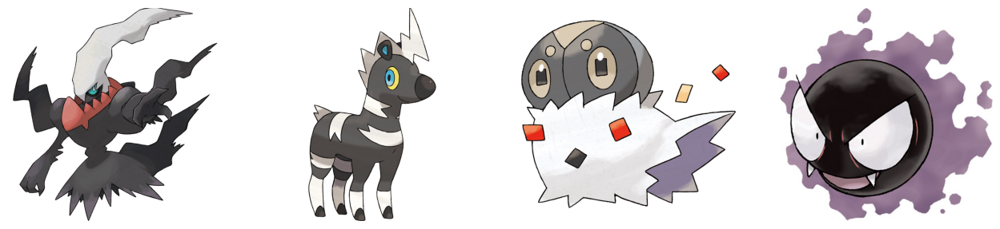

### Matched by raw image

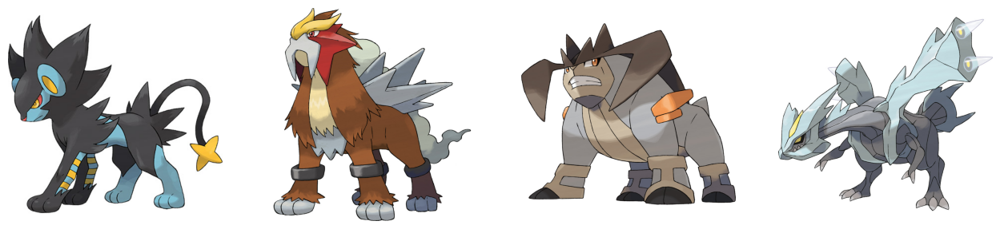

---

---

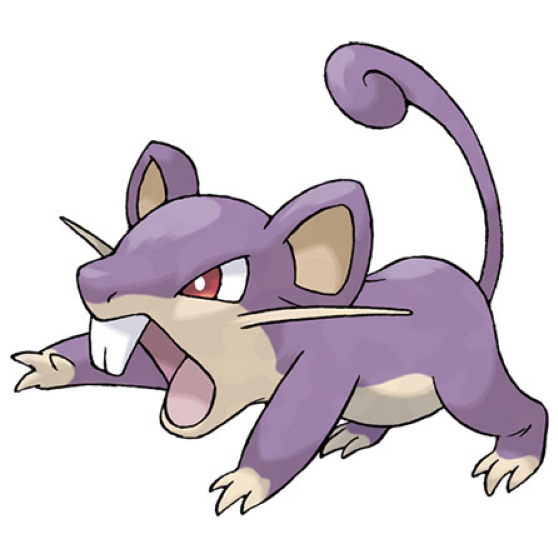

1. The creature is purple.
2. The creature looks unfriendly due to its open mouth and the way it is positioned, suggesting it is ready to attack or defend itself.

### Matched by generated text

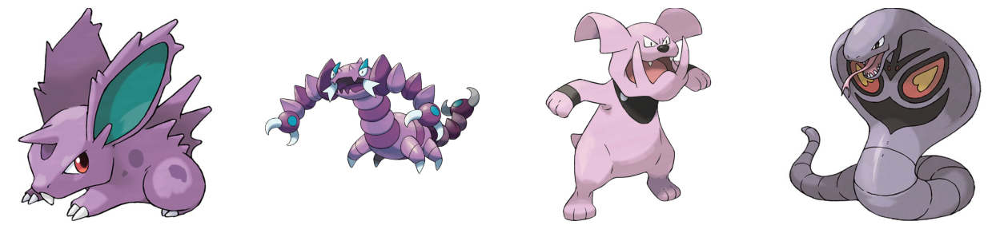

### Matched by raw image

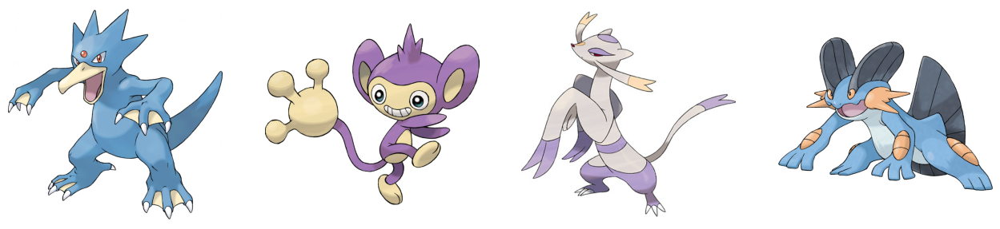

---

---

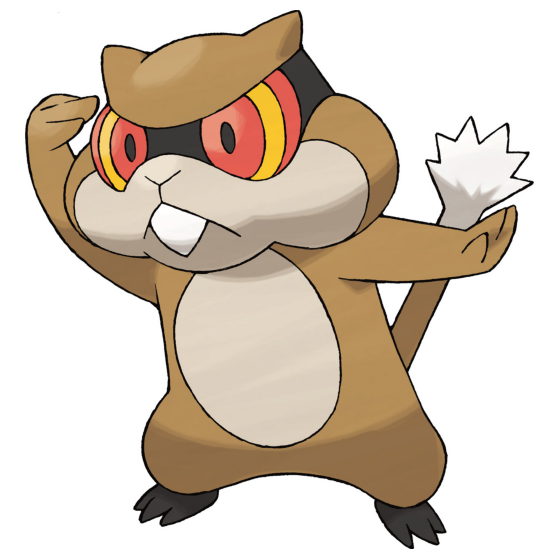

1. The creature is brown.
2. The creature looks unfriendly due to its wide eyes, sharp teeth, and the overall aggressive stance with its arms outstretched.

### Matched by generated text

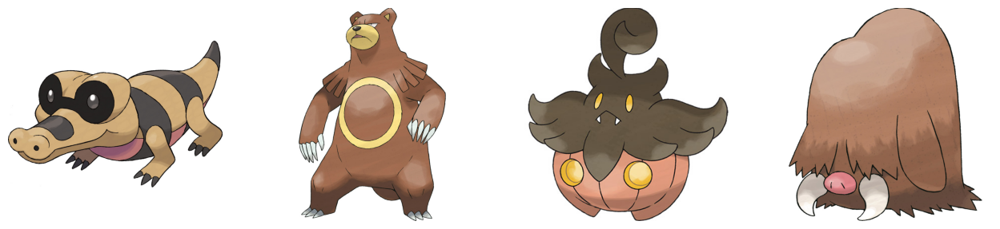

### Matched by raw image

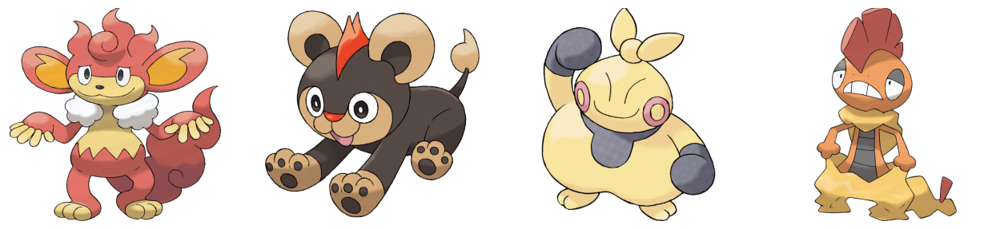

---

---

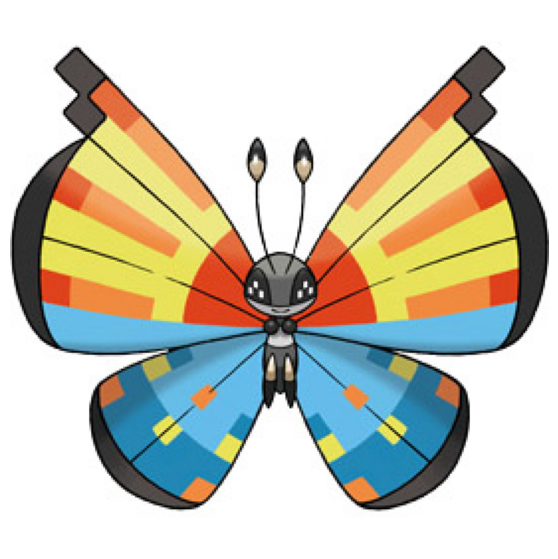

1. What color is the creature?: The creature is predominantly blue with orange and yellow accents.
2. How friendly or unfriendly does the creature look and why do you think that?: The creature has a neutral or indifferent expression, with a slight smile that suggests it may be friendly or at least not hostile.

### Matched by generated text

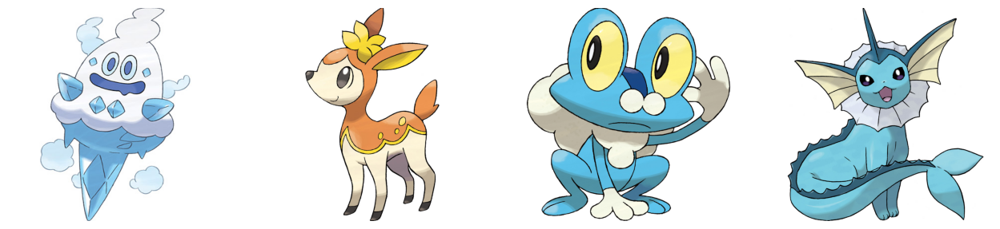

### Matched by raw image

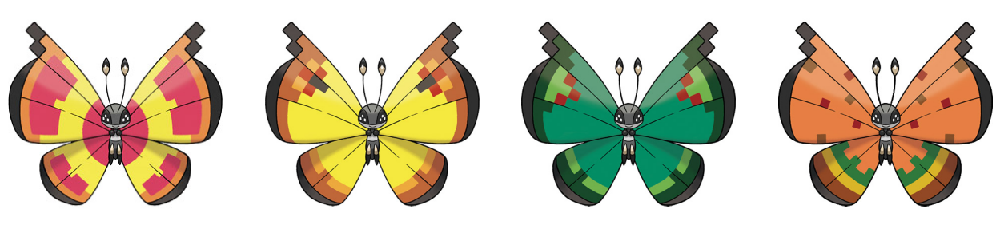

---

---

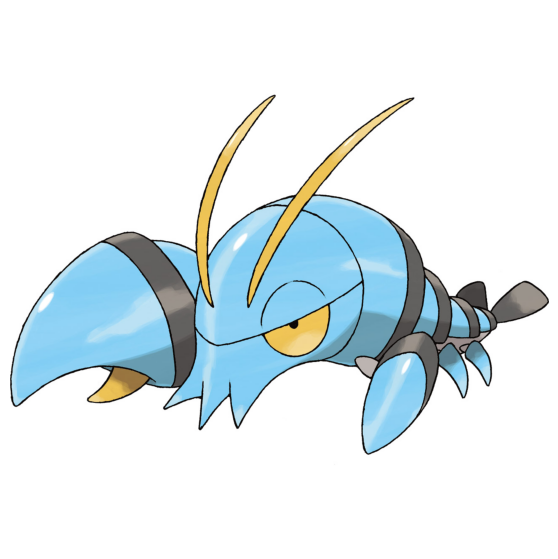

1. The creature is blue.
2. The creature looks unfriendly due to its sharp teeth and the menacing expression on its face.

### Matched by generated text

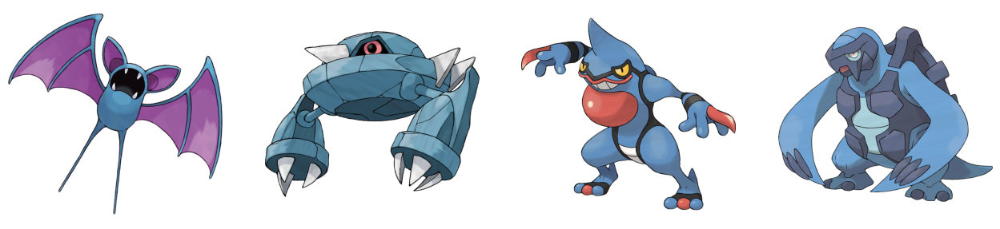

### Matched by raw image

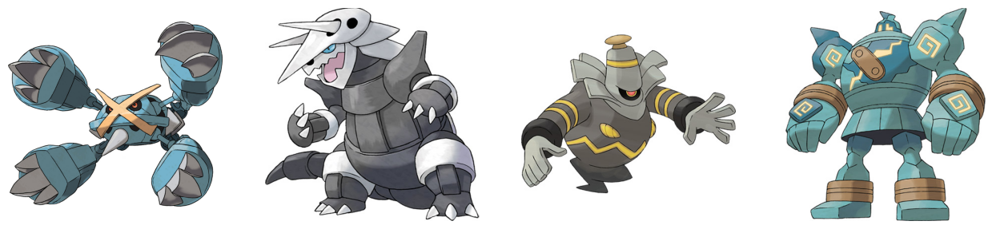

---

---

In [7]:
for text_match_i, image_match_i in zip(text_neighbors, image_neighbors):
    i = text_match_i[0]
    ds_i = int(data.loc[i, 'index'])
    graph.figure(figsize=(7, 7))
    graph.imshow(image_ds['train'][ds_i]['image'])
    graph.axis('off')
    graph.show()
    display(Markdown(data.loc[i, 'response']))

    display(Markdown('### Matched by generated text'))
    graph.figure(figsize=(20, 5))
    for col, j in enumerate(text_match_i[1:]):
        ds_j = int(data.loc[j, 'index'])
        graph.subplot(1, 5, col+1)
        graph.imshow(image_ds['train'][ds_j]['image'])
        graph.axis('off')
    graph.show()

    display(Markdown('### Matched by raw image'))
    graph.figure(figsize=(20, 5))
    for col, j in enumerate(image_match_i[1:]):
        ds_j = int(data.loc[j, 'index'])
        graph.subplot(1, 5, col+1)
        graph.imshow(image_ds['train'][ds_j]['image'])
        graph.axis('off')
    graph.show()

    display(Markdown('---'))
    display(Markdown('---'))